# Capstone Project (Wizeline Bootcamp)
## Air Quality Dataset Analysis
### Daniel Martínez Escobosa (Entrega 1)

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from scipy import stats
from scipy.stats import skew, kurtosis
import datetime
from sklearn.linear_model import LinearRegression
from sklearn.metrics import *
from sklearn.model_selection import cross_val_score, GridSearchCV, TimeSeriesSplit, train_test_split
from sklearn.preprocessing import MinMaxScaler

## <b>Cargando y entendiendo el dataset</b>
Lectura y análisis del dataset.

Attribute Information:

0. Date (DD/MM/YYYY)
1. Time (HH.MM.SS)
2. CO_GT - True hourly averaged concentration CO in mg/m^3 
3. PT08_S1_CO - PT08.S1 (tin oxide) hourly averaged sensor response (nominally CO targeted)
4. C6H6_GT- True hourly averaged overall Non Metanic HydroCarbons concentration in microg/m^3 (reference analyzer)
5. True hourly averaged Benzene concentration in microg/m^3 (reference analyzer)
6. PT08_S2_NMHC-  PT08.S2 (titania) hourly averaged sensor response (nominally NMHC targeted)
7. Nox_GT- True hourly averaged Nitric oxide  concentration in ppb (reference analyzer)
8. PT08_S3_Nox- PT08.S3 (tungsten oxide) hourly averaged sensor response (nominally NOx targeted)
9. NO2_GT- True hourly averaged NO2 concentration in microg/m^3 (reference analyzer)
10. PT08_S4_NO2- PT08.S4 (tungsten oxide) hourly averaged sensor response (nominally NO2 targeted)
11. PT08_S5_O3 - PT08.S5 (indium oxide) hourly averaged sensor response (nominally O3 targeted)
12. T - Temperature in Â°C
13. RH- Relative Humidity (%)
14. AH -  Absolute Humidity

In [2]:
#Se importa dataset
raw_data = pd.read_csv('AirQualityUCI.csv', sep=';', decimal=',',parse_dates=[['Date','Time']])

In [3]:
#Se visualiza head de primeros 5 registros de información
raw_data.head()

,Date_Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
0,10/03/2004 18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,NaN,NaN
1,10/03/2004 19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,NaN,NaN
2,10/03/2004 20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,NaN,NaN
3,10/03/2004 21.00.00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,NaN,NaN
4,10/03/2004 22.00.00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,NaN,NaN


## <b>Limpieza general del dataset</b>

In [4]:
#Se visualiza que figuran dos columnas extra (nulas) al extremo derecho de la matriz tabular que hay que remover
raw_data = raw_data.iloc[:, :-2]
raw_data.head()

,Date_Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004 18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004 19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004 20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,10/03/2004 21.00.00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,10/03/2004 22.00.00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


In [5]:
raw_data.shape

(9471, 14)

In [6]:
#Viendo el resultado del tamaño de la matriz de datos y que según la bibliografía deberian ser únicamente 9358 filas, se indaga en las últimas filas a ver si hay filas "basura".
raw_data.tail()

,Date_Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
9466,nan nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9467,nan nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9468,nan nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9469,nan nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9470,nan nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
#Visualmente abriendo el csv o xlsx, se comprueba que a partir de la fila 9356 sólo hay filas con valores nulos, las cuales eliminaremos del dataset
raw_data.loc[[9357]]

,Date_Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
9357,nan nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
#Procediendo a eliminar filas del dataset se asegura tener el dataset limpios de filas y columnas llenas de valores nulos y lograr la coincidencia de dimensión del dataset según la bibliografía.
raw_data = raw_data.head(9357)
raw_data.shape

(9357, 14)

## <b>Preprocesamiento del dataset</b>

In [9]:
#Ahora se procede a estudiar la información del dataset mediante la generación de estadística descriptiva
raw_data.describe()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
count,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000
mean,-34.207524,1048.990061,-159.090093,1.865683,894.595276,168.616971,794.990168,58.148873,1391.479641,975.072032,9.778305,39.485380,-6.837604
std,77.657170,329.832710,139.789093,41.380206,342.333252,257.433866,321.993552,126.940455,467.210125,456.938184,43.203623,51.216145,38.976670
min,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000
25%,0.600000,921.000000,-200.000000,4.000000,711.000000,50.000000,637.000000,53.000000,1185.000000,700.000000,10.900000,34.100000,0.692300
50%,1.500000,1053.000000,-200.000000,7.900000,895.000000,141.000000,794.000000,96.000000,1446.000000,942.000000,17.200000,48.600000,0.976800
75%,2.600000,1221.000000,-200.000000,13.600000,1105.000000,284.000000,960.000000,133.000000,1662.000000,1255.000000,24.100000,61.900000,1.296200
max,11.900000,2040.000000,1189.000000,63.700000,2214.000000,1479.000000,2683.000000,340.000000,2775.000000,2523.000000,44.600000,88.700000,2.231000


In [10]:
#Y también revisando el tipo de dato de cada campo
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9357 entries, 0 to 9356
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date_Time      9357 non-null   object 
 1   CO(GT)         9357 non-null   float64
 2   PT08.S1(CO)    9357 non-null   float64
 3   NMHC(GT)       9357 non-null   float64
 4   C6H6(GT)       9357 non-null   float64
 5   PT08.S2(NMHC)  9357 non-null   float64
 6   NOx(GT)        9357 non-null   float64
 7   PT08.S3(NOx)   9357 non-null   float64
 8   NO2(GT)        9357 non-null   float64
 9   PT08.S4(NO2)   9357 non-null   float64
 10  PT08.S5(O3)    9357 non-null   float64
 11  T              9357 non-null   float64
 12  RH             9357 non-null   float64
 13  AH             9357 non-null   float64
dtypes: float64(13), object(1)
memory usage: 1023.5+ KB


In [11]:
#A sabiendas de la bibliografía del dataset (repositorio UCI), en la que se menciona que los valores faltantes están rellenados con el valor de "-200", se procede a cerciorar que no existan valores nulos (que por alguna situación no tengan cargado el -200) a lo largo del dataset previo al tratamiento de los "-200".
raw_data.isnull().sum()

Date_Time        0
CO(GT)           0
PT08.S1(CO)      0
NMHC(GT)         0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
dtype: int64

In [12]:
#Ya que, salvo las dos primeras columnas de tiempo son tipo numérico flotante, se puede hacer el conteo de valores faltantes por columna contando cuántas veces hay "-200"
raw_data.isin([-200]).sum(axis=0)

Date_Time           0
CO(GT)           1683
PT08.S1(CO)       366
NMHC(GT)         8443
C6H6(GT)          366
PT08.S2(NMHC)     366
NOx(GT)          1639
PT08.S3(NOx)      366
NO2(GT)          1642
PT08.S4(NO2)      366
PT08.S5(O3)       366
T                 366
RH                366
AH                366
dtype: int64

In [13]:
#Y ahora se reemplazan dichos valores a NaN para poder estudiar la distribución de información no nula de cada variable y poder proponer un método de imputación adecuado a cada caso
trusted_data = raw_data.replace(to_replace = -200, value = np.NaN)
trusted_data.isnull().sum()

Date_Time           0
CO(GT)           1683
PT08.S1(CO)       366
NMHC(GT)         8443
C6H6(GT)          366
PT08.S2(NMHC)     366
NOx(GT)          1639
PT08.S3(NOx)      366
NO2(GT)          1642
PT08.S4(NO2)      366
PT08.S5(O3)       366
T                 366
RH                366
AH                366
dtype: int64

In [14]:
#Formato date_time
def clear_datetime(column):
  column_replaced = column.replace('/','-').replace('.',':')
  column_cleared = pd.to_datetime(column_replaced, dayfirst=True)
  return column_cleared

trusted_data['Date_Time'] = trusted_data['Date_Time'].apply(lambda x: clear_datetime(x))
trusted_data.set_index('Date_Time', inplace=True)
trusted_data.head()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
Date_Time,,,,,,,,,,,,,
2004-03-10 18:00:00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
2004-03-10 19:00:00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2004-03-10 20:00:00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
2004-03-10 21:00:00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
2004-03-10 22:00:00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


### <b>Exploración del dataset a través de estadística descriptiva al dataset</b>

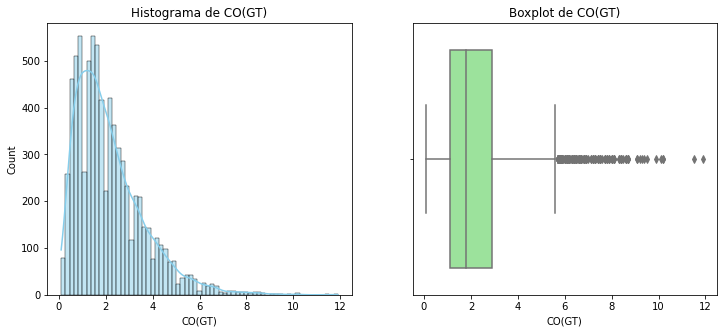

Variable: CO(GT)
Skewness: 1.37
Kurtosis: 2.67
Número de outliers: 102



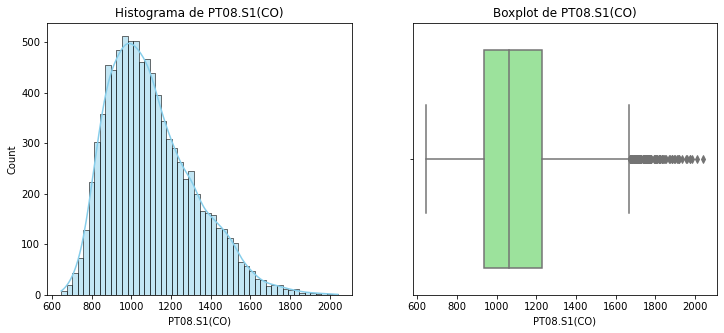

Variable: PT08.S1(CO)
Skewness: 0.76
Kurtosis: 0.33
Número de outliers: 60



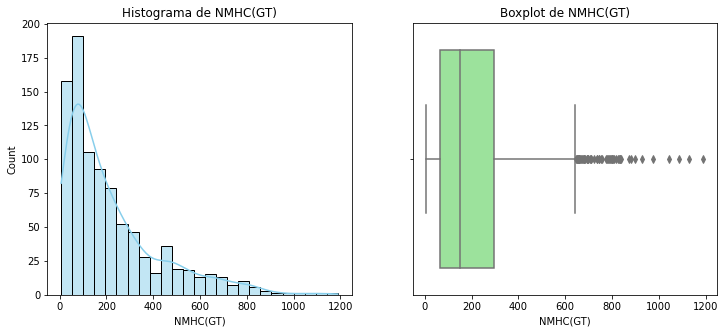

Variable: NMHC(GT)
Skewness: 1.55
Kurtosis: 2.25
Número de outliers: 11



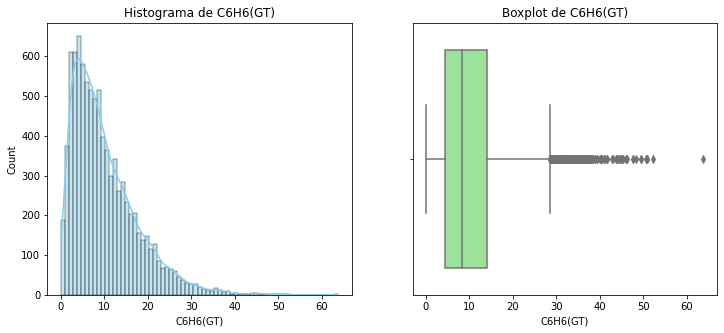

Variable: C6H6(GT)
Skewness: 1.36
Kurtosis: 2.49
Número de outliers: 118



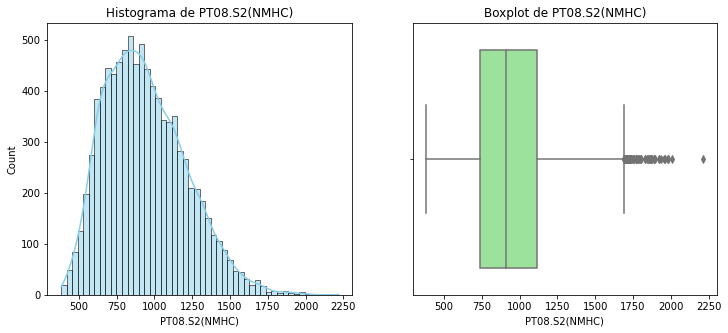

Variable: PT08.S2(NMHC)
Skewness: 0.56
Kurtosis: 0.06
Número de outliers: 37



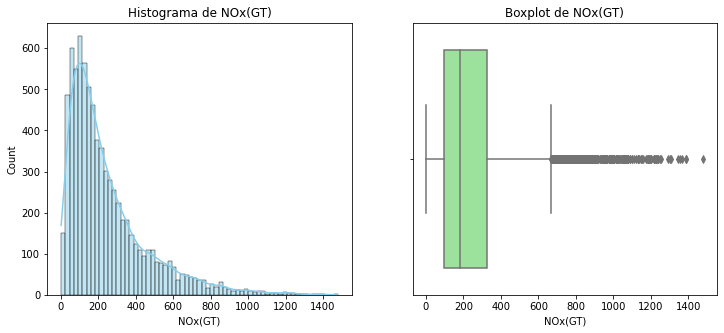

Variable: NOx(GT)
Skewness: 1.72
Kurtosis: 3.40
Número de outliers: 138



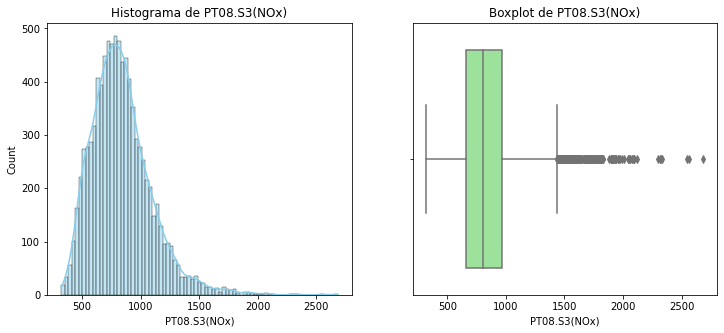

Variable: PT08.S3(NOx)
Skewness: 1.10
Kurtosis: 2.68
Número de outliers: 109



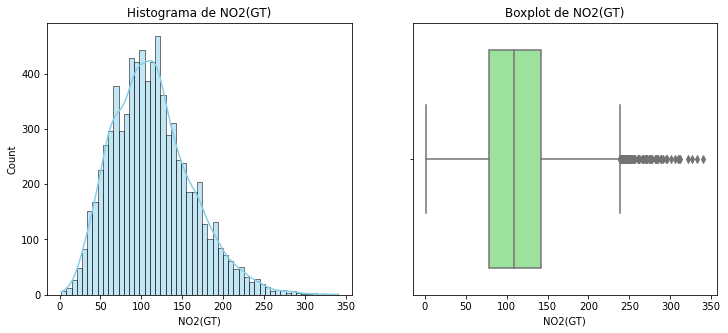

Variable: NO2(GT)
Skewness: 0.62
Kurtosis: 0.46
Número de outliers: 48



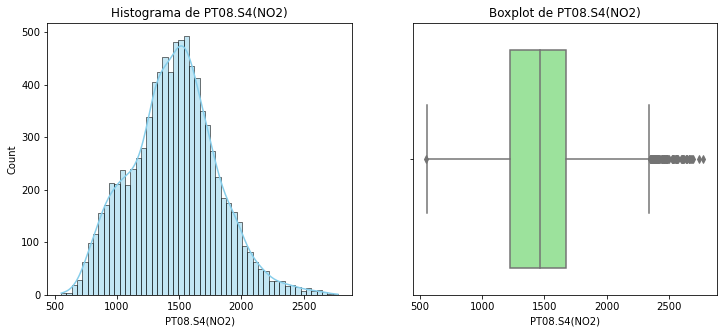

Variable: PT08.S4(NO2)
Skewness: 0.21
Kurtosis: 0.08
Número de outliers: 38



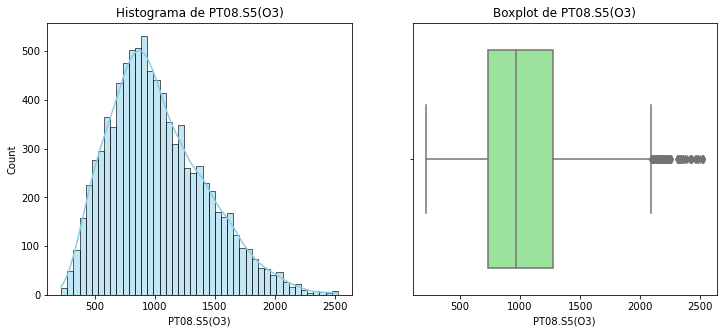

Variable: PT08.S5(O3)
Skewness: 0.63
Kurtosis: 0.08
Número de outliers: 37



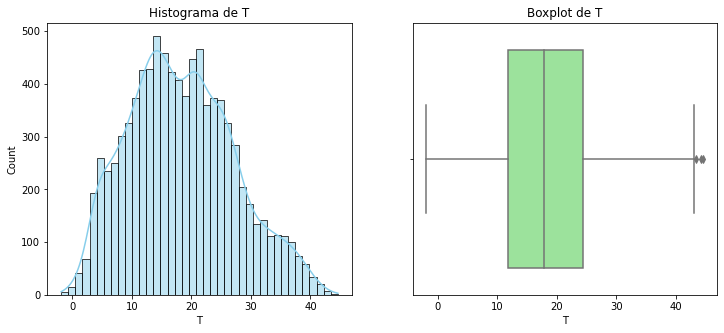

Variable: T
Skewness: 0.31
Kurtosis: -0.46
Número de outliers: 0



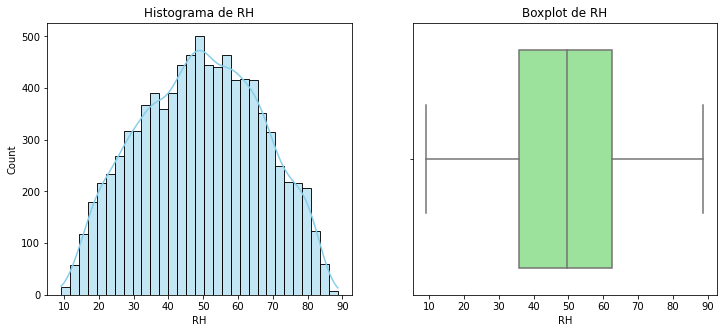

Variable: RH
Skewness: -0.04
Kurtosis: -0.82
Número de outliers: 0



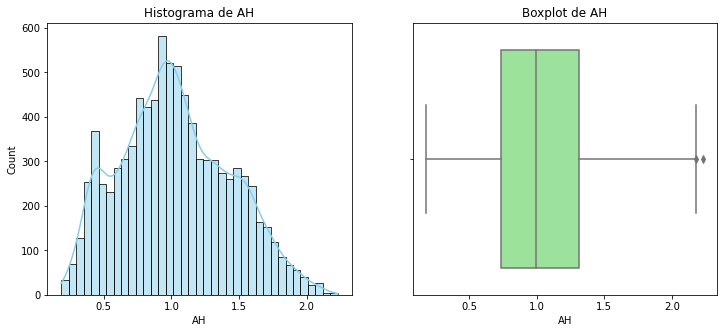

Variable: AH
Skewness: 0.25
Kurtosis: -0.56
Número de outliers: 0



In [15]:
# Graficar histogramas y boxplots, y calcular sesgo, curtosis y número de registros outliers

def plot_hist_boxplot_skew_kurt_outliers(dataframe):
    """
    Esta función grafica histogramas y boxplots para cada columna del DataFrame,
    calcula y muestra la skewness y la kurtosis para los valores no nulos de cada columna,
    e identifica outliers asumiendo como tal a aquel dato que esté por fuera de 3 desviaciones estándar de la media.
    
    """
    for column in dataframe.columns:
        plt.figure(figsize=(12, 5))
        
        # Histograma
        plt.subplot(1, 2, 1)
        sns.histplot(dataframe[column], kde=True, color='skyblue')
        plt.title(f'Histograma de {column}')
        
        # Boxplot
        plt.subplot(1, 2, 2)
        sns.boxplot(x=dataframe[column], color='lightgreen')
        plt.title(f'Boxplot de {column}')
        
        plt.show()

        # Filtrar valores no nulos
        non_null_values = dataframe[column].dropna()

        # Calcular y mostrar skewness y kurtosis
        skewness = skew(non_null_values)
        kurt = kurtosis(non_null_values)
        print(f'Variable: {column}')
        print(f'Skewness: {skewness:.2f}')
        print(f'Kurtosis: {kurt:.2f}')

        # Calcular el número de outliers
        mean = non_null_values.mean()
        std = non_null_values.std()
        outliers = non_null_values[(non_null_values < (mean - 3 * std)) | (non_null_values > (mean + 3 * std))]
        print(f'Número de outliers: {len(outliers)}')
        print()

plot_hist_boxplot_skew_kurt_outliers(trusted_data)

### Estudiando correlaciones entre diferentes gases

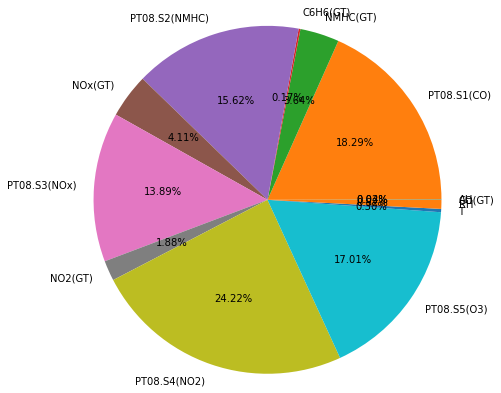

In [16]:
trusted_data.mean().plot.pie(ylabel='',radius = 2,autopct = "%.2f%%");

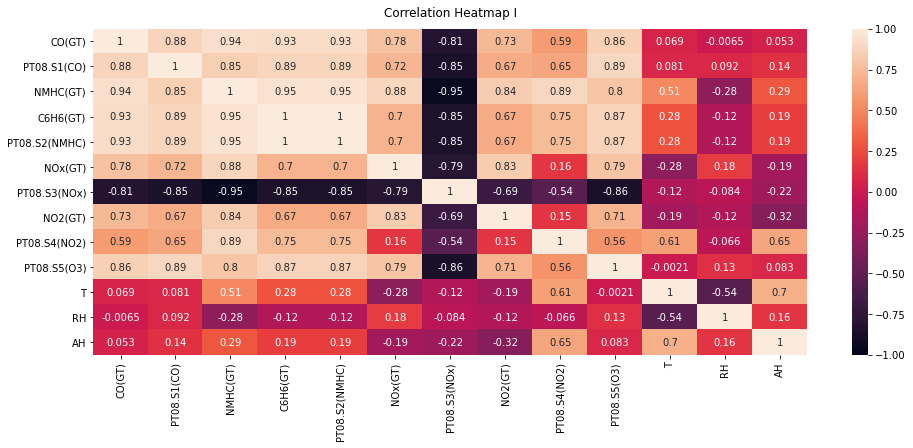

In [17]:
#Se visualizan correlaciones entre variables para estudio y entendimiento de datos
import seaborn as sb
plt.figure(figsize=(16, 6))
heatmap = sb.heatmap(trusted_data.corr(method='spearman'), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap I', fontdict={'fontsize':12}, pad=12);


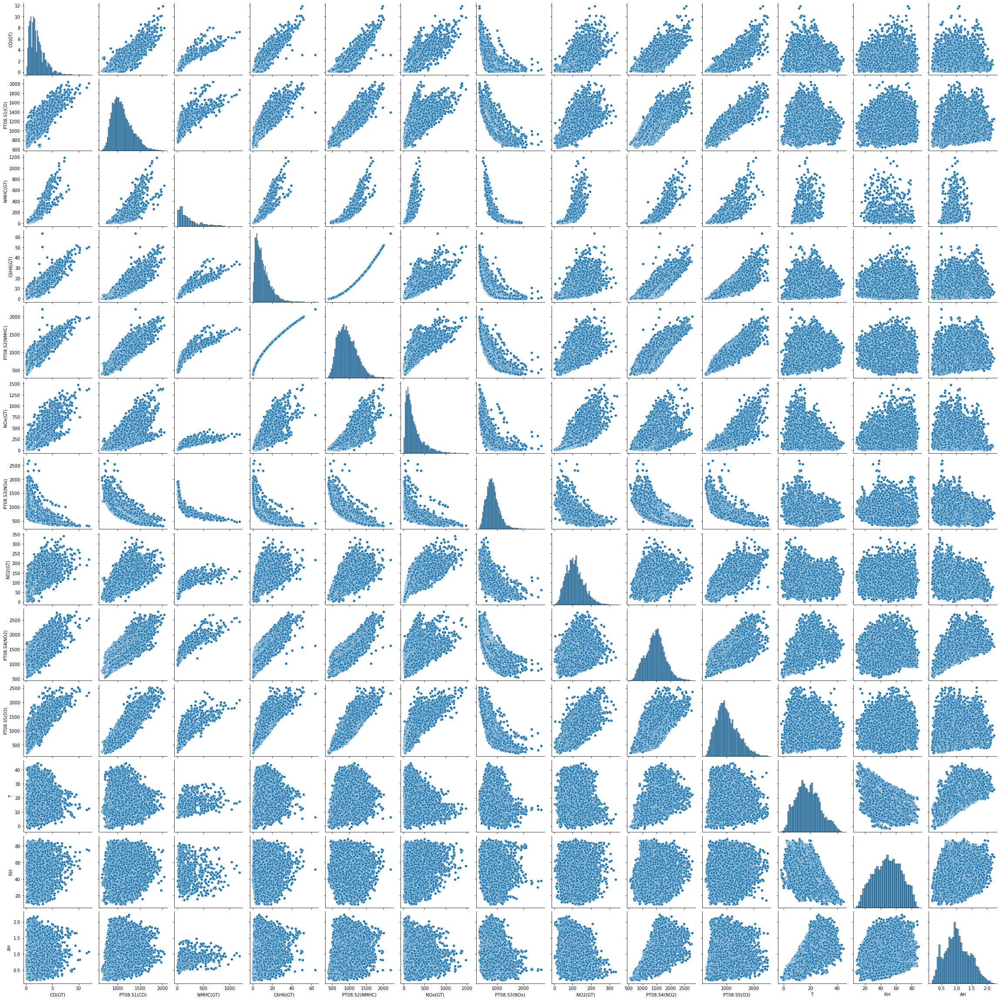

In [18]:
sns.pairplot(trusted_data)

### <b>Lidiando con la información faltante del dataset</b>

In [19]:
#Alternativa 1. Imputación de datos faltantes. Se define criterio individual para cada variable según su distribución.
imputation_methods = {
    'CO(GT)': 'median',
    'PT08.S1(CO)': 'mean',
    'NMHC(GT)': 'median',
    'C6H6(GT)': 'median',
    'PT08.S2(NMHC)': 'mean',
    'NOx(GT)': 'mean',
    'PT08.S3(NOx)': 'mean',
    'NO2(GT)': 'mean',
    'PT08.S4(NO2)': 'mean',
    'PT08.S5(O3)': 'mean',
    'T': 'mean',
    'RH': 'mean',
    'AH': 'mean'
}

# Se itera sobre el diccionario y se aplica el método de imputación correspondiente a cada columna
for column, method in imputation_methods.items():
    if method == 'mean':
        trusted_data[column].fillna(trusted_data[column].mean(), inplace=True)
    elif method == 'median':
        trusted_data[column].fillna(trusted_data[column].median(), inplace=True)
    elif method == 'mode':
        trusted_data[column].fillna(trusted_data[column].mode()[0], inplace=True)
    else:
        print(f'Método de imputación no válido para la columna {column}: {method}')


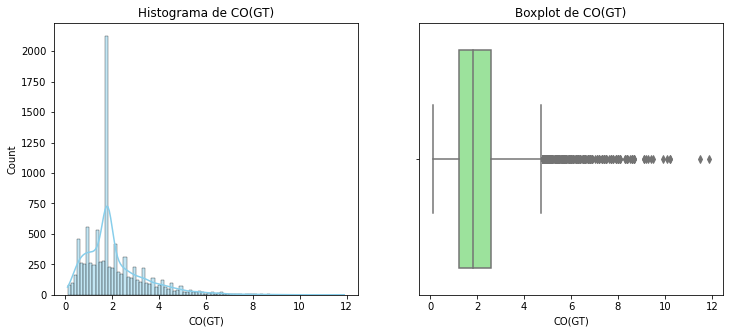

Variable: CO(GT)
Skewness: 1.63
Kurtosis: 4.06
Número de outliers: 157



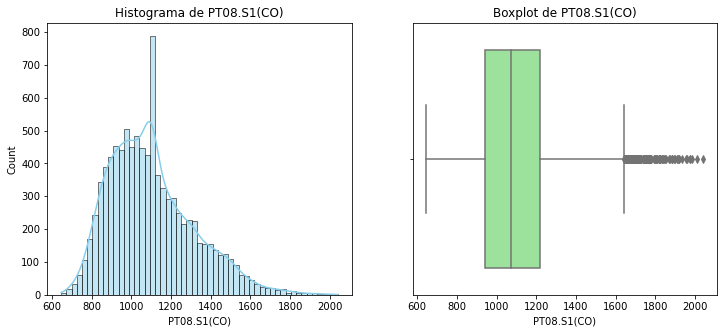

Variable: PT08.S1(CO)
Skewness: 0.77
Kurtosis: 0.47
Número de outliers: 70



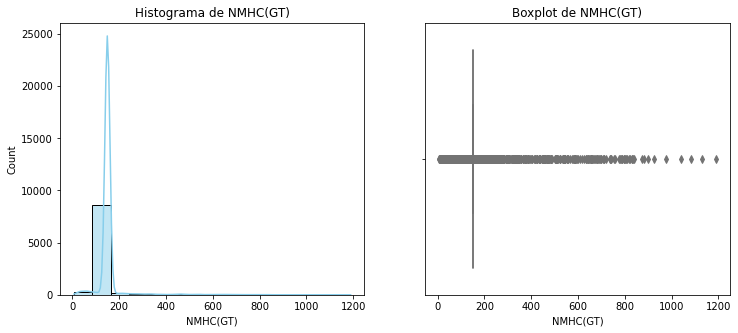

Variable: NMHC(GT)
Skewness: 6.89
Kurtosis: 61.90
Número de outliers: 175



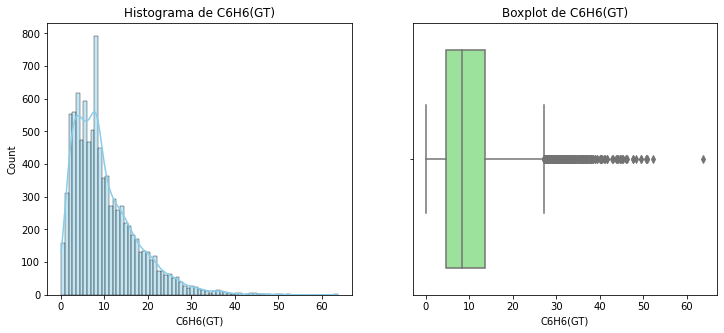

Variable: C6H6(GT)
Skewness: 1.41
Kurtosis: 2.74
Número de outliers: 131



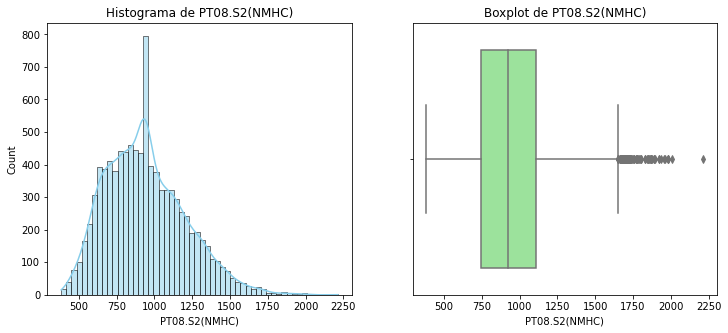

Variable: PT08.S2(NMHC)
Skewness: 0.57
Kurtosis: 0.19
Número de outliers: 45



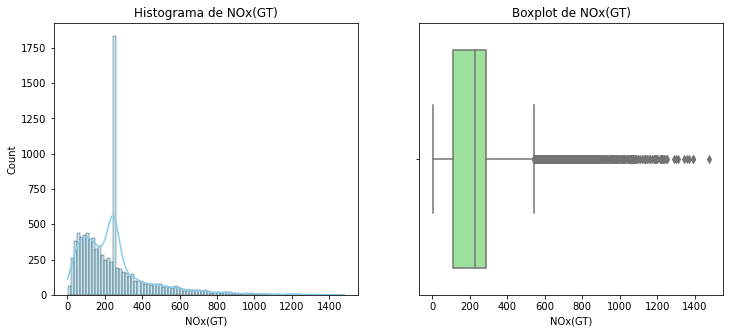

Variable: NOx(GT)
Skewness: 1.89
Kurtosis: 4.76
Número de outliers: 198



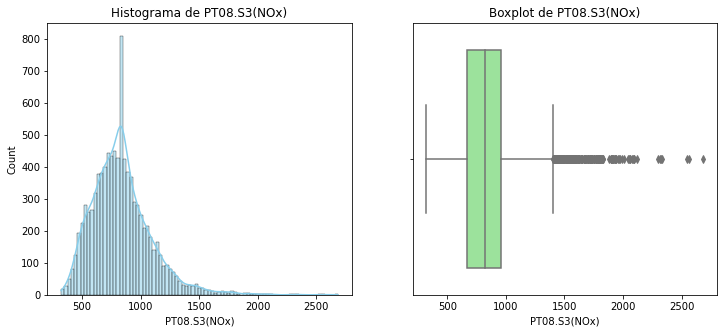

Variable: PT08.S3(NOx)
Skewness: 1.12
Kurtosis: 2.91
Número de outliers: 114



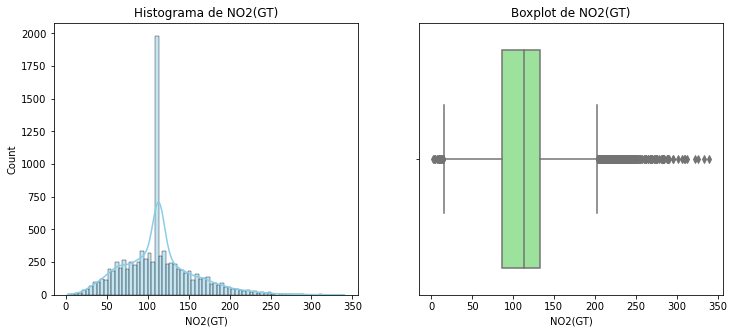

Variable: NO2(GT)
Skewness: 0.68
Kurtosis: 1.20
Número de outliers: 81



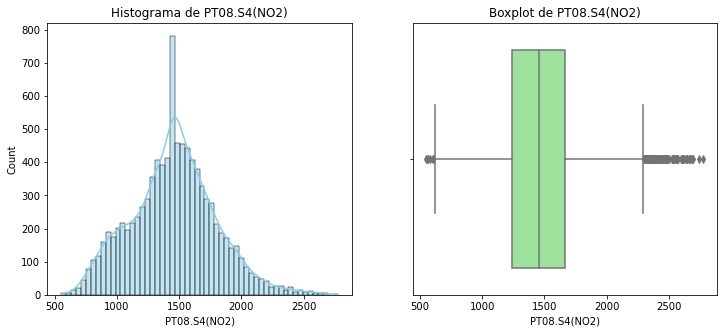

Variable: PT08.S4(NO2)
Skewness: 0.21
Kurtosis: 0.20
Número de outliers: 44



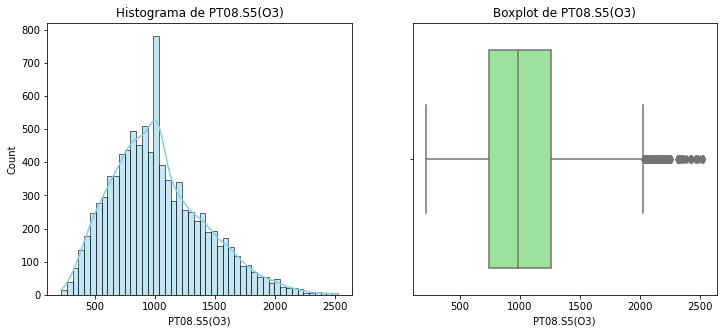

Variable: PT08.S5(O3)
Skewness: 0.64
Kurtosis: 0.20
Número de outliers: 48



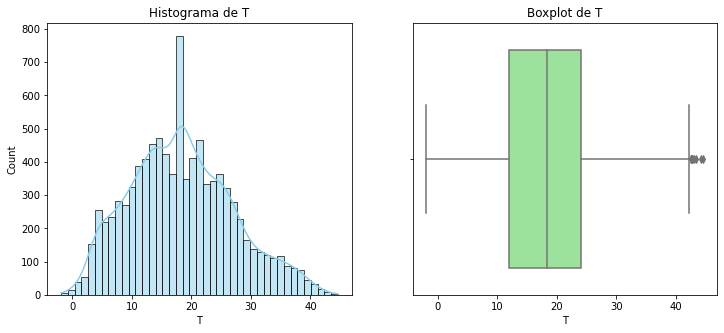

Variable: T
Skewness: 0.32
Kurtosis: -0.35
Número de outliers: 2



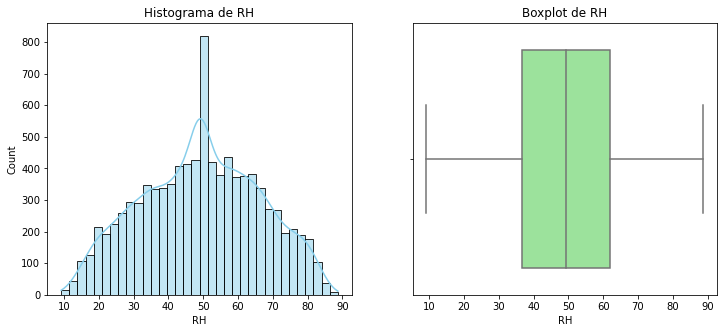

Variable: RH
Skewness: -0.04
Kurtosis: -0.73
Número de outliers: 0



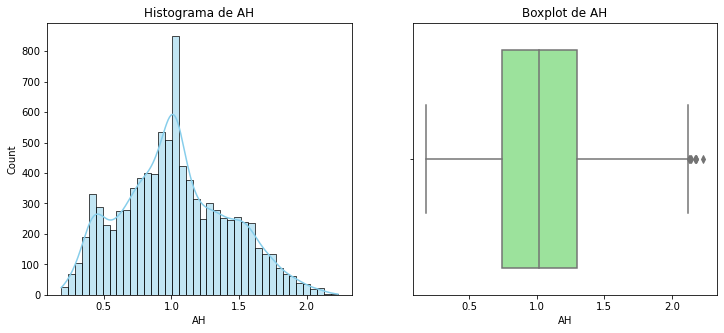

Variable: AH
Skewness: 0.26
Kurtosis: -0.46
Número de outliers: 1



In [20]:
plot_hist_boxplot_skew_kurt_outliers(trusted_data)

In [21]:
#Observando que la variable NMHC tiene demasiados valores faltantes (90.23% son faltantes), y ninguno de los métodos de imputación probados arrojan buenos resultados, quitamos del dataset. Nota: si más adelante no se obtienen buenos resultados con los modelos, podríamos regresar a rescatar la variable  avanzados como interpolación o modelos de machine learning.
trusted_data = trusted_data.drop(['NMHC(GT)'],axis='columns')
trusted_data.head()

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
Date_Time,,,,,,,,,,,,
2004-03-10 18:00:00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
2004-03-10 19:00:00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2004-03-10 20:00:00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
2004-03-10 21:00:00,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
2004-03-10 22:00:00,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


In [22]:
# Antes de tu bucle for, resetea el índice para convertir 'Date_time' en una columna
trusted_data_reset = trusted_data.reset_index()

trusted_data_reset.head()

,Date_Time,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2004-03-10 18:00:00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,2004-03-10 19:00:00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,2004-03-10 20:00:00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,2004-03-10 21:00:00,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,2004-03-10 22:00:00,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


In [23]:
# Ahora 'Date_time' es una columna y puedes usarla en tu gráfico
for i in trusted_data_reset.columns[1:13]:
    fig = px.scatter(trusted_data_reset, x="Date_Time", y=i, color=i)
    fig.show()

### <b>Tratamiento Outliers del dataset</b>

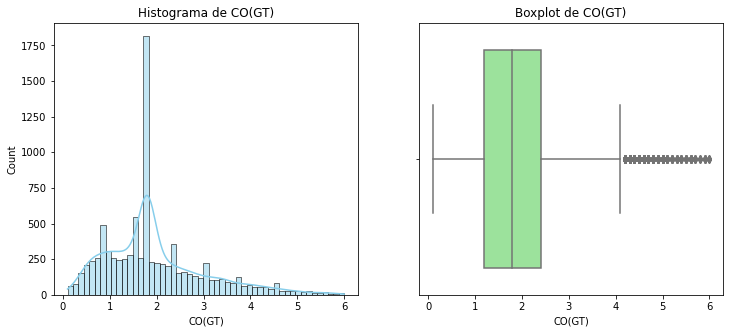

Variable: CO(GT)
Skewness: 1.00
Kurtosis: 0.98
Número de outliers: 100



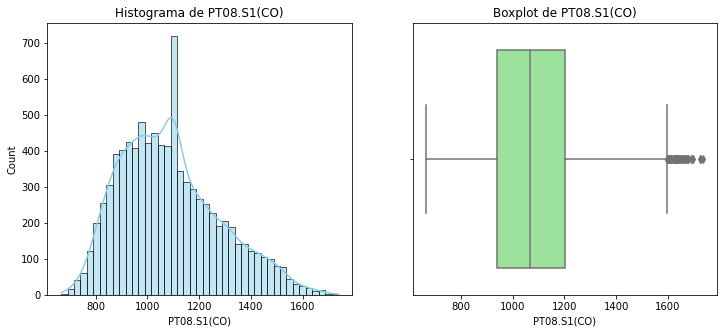

Variable: PT08.S1(CO)
Skewness: 0.57
Kurtosis: -0.15
Número de outliers: 20



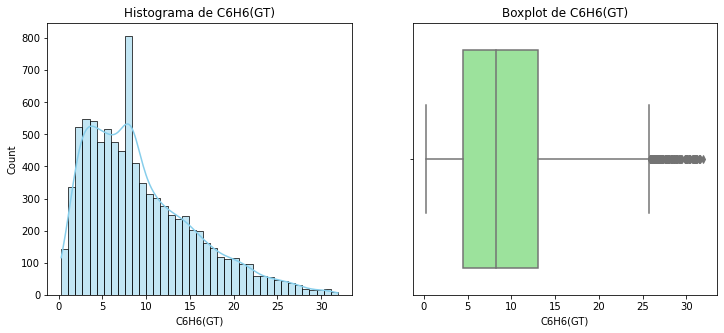

Variable: C6H6(GT)
Skewness: 0.96
Kurtosis: 0.49
Número de outliers: 68



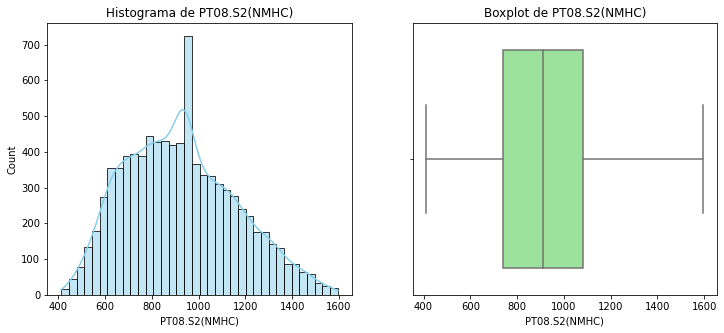

Variable: PT08.S2(NMHC)
Skewness: 0.36
Kurtosis: -0.44
Número de outliers: 0



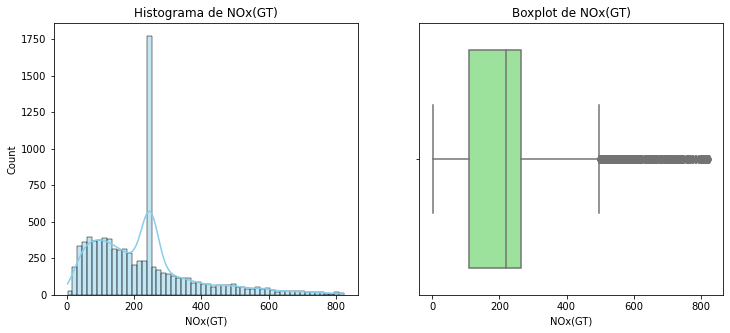

Variable: NOx(GT)
Skewness: 1.26
Kurtosis: 1.74
Número de outliers: 150



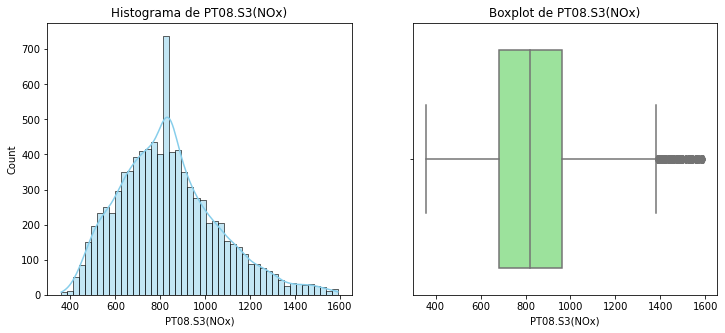

Variable: PT08.S3(NOx)
Skewness: 0.63
Kurtosis: 0.34
Número de outliers: 54



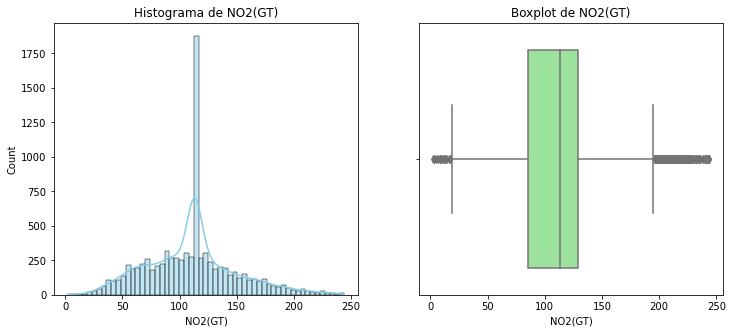

Variable: NO2(GT)
Skewness: 0.39
Kurtosis: 0.38
Número de outliers: 38



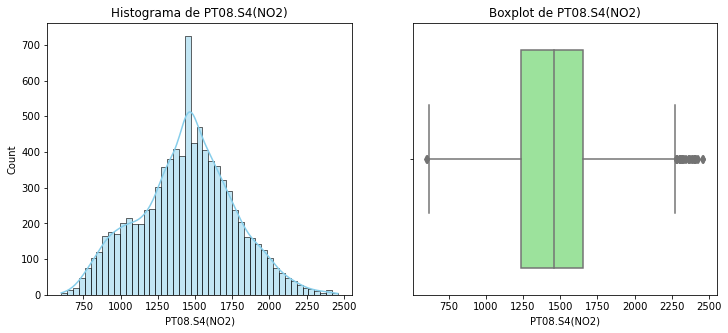

Variable: PT08.S4(NO2)
Skewness: 0.02
Kurtosis: -0.21
Número de outliers: 6



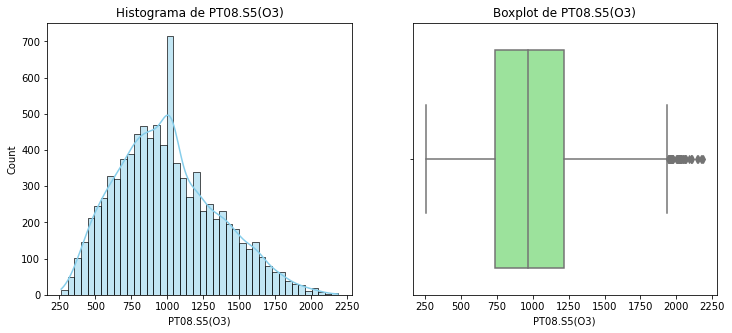

Variable: PT08.S5(O3)
Skewness: 0.47
Kurtosis: -0.23
Número de outliers: 14



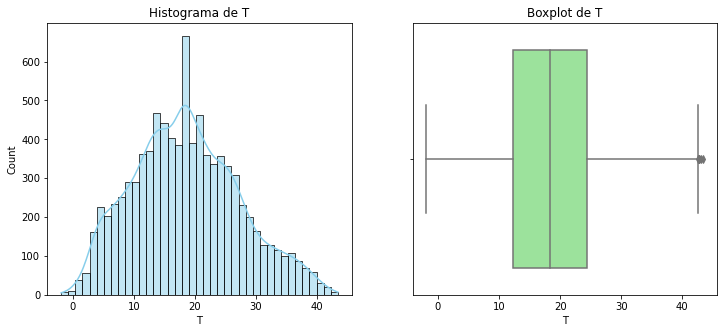

Variable: T
Skewness: 0.29
Kurtosis: -0.39
Número de outliers: 0



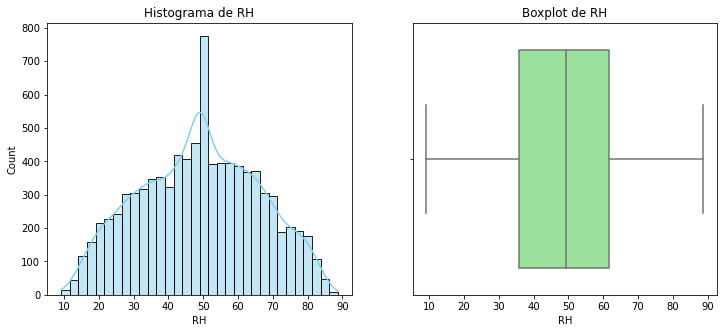

Variable: RH
Skewness: -0.02
Kurtosis: -0.75
Número de outliers: 0



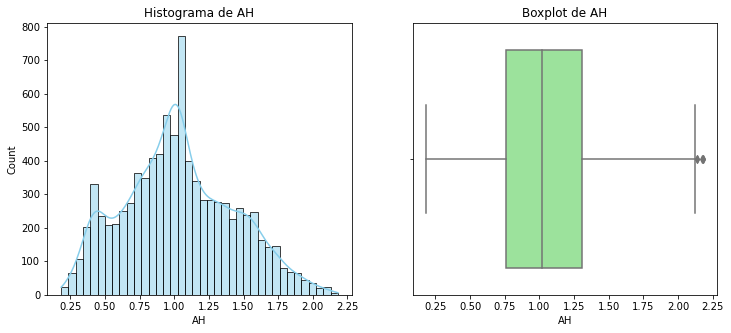

Variable: AH
Skewness: 0.23
Kurtosis: -0.47
Número de outliers: 0



In [24]:
#Tratamiento Outliers. 
#Se define función que da tratamiento a outliers previo a realizar transformaciones de datos para buscar distribuciones lo más simétricas posibles (cercanas a 0 en skew)
def remove_outliers(dataframe):
    """
    Elimina outliers de un DataFrame de pandas basado en la regla de 3 desviaciones estándar.
    
    """
    dataframe_cleaned = dataframe.copy()
    for column in dataframe.columns:
        if pd.api.types.is_numeric_dtype(dataframe[column]):
            mean = dataframe[column].mean()
            std_dev = dataframe[column].std()
            
            # Calcular límites para identificar outliers
            cut_off = std_dev * 3
            lower, upper = mean - cut_off, mean + cut_off
            
            # Filtrar outliers
            dataframe_cleaned = dataframe_cleaned[(dataframe_cleaned[column] > lower) & (dataframe_cleaned[column] < upper)]
    
    return dataframe_cleaned

# Se aplica la función al dataframe y se imprime también reporte de plots
trusted_data = remove_outliers(trusted_data)
trusted_data.shape
plot_hist_boxplot_skew_kurt_outliers(trusted_data)

### <b>Transformación de datos del dataset</b>
Transformación Box-Cox.

In [25]:
#Transformaciones para mitigar sesgo
#Se propone la transformación boxcox para lidiar con el sesgo dañino previo a entrenamiento de modelos.
def transform_box_cox(trusted_data):
    """
    Aplica la transformación Box-Cox a las columnas de un DataFrame
    cuyo skew sea superior a 1.5 o menor a -1.5. Imprime las variables transformadas,
    su skew antes y después de la transformación, y el valor de lambda utilizado.
    Indica si no fue necesario realizar ninguna transformación.

    Parámetros:
    - trusted_data: DataFrame de pandas con variables numéricas.

    Retorna:
    - DataFrame con las transformaciones aplicadas.
    """
    # Variable para rastrear si alguna columna fue transformada
    transformation_applied = False

    for column in trusted_data.columns:
        # Verificar que la columna sea de tipo numérico
        if pd.api.types.is_numeric_dtype(trusted_data[column]):
            skewness_before = trusted_data[column].skew()
            # Verificar el skewness de la columna
            if skewness_before > 1.25 or skewness_before < -1.25:
                # Asegurarse de que todos los valores sean positivos
                if all(trusted_data[column] > 0):
                    # Aplicar la transformación Box-Cox
                    transformed_data, best_lambda = stats.boxcox(trusted_data[column])
                    trusted_data[column] = transformed_data
                    skewness_after = trusted_data[column].skew()
                    print(f"Columna '{column}': Skew antes = {skewness_before:.2f}, Skew después = {skewness_after:.2f}, Lambda = {best_lambda:.2f}")
                    transformation_applied = True
                else:
                    print(f"La columna '{column}' contiene valores no positivos y no se transformará.")
        else:
            print(f"La columna '{column}' no es numérica y será ignorada.")

    if not transformation_applied:
        print("No fue necesario realizar ninguna transformación Box-Cox bajo el criterio de sesgo establecido.")

    #return trusted_data

transform_box_cox(trusted_data)

Columna 'NOx(GT)': Skew antes = 1.26, Skew después = -0.02, Lambda = 0.31


### <b>Reducción Dimensional de datos del dataset</b>
Criterio escogido: correlación entre variables del dataset.

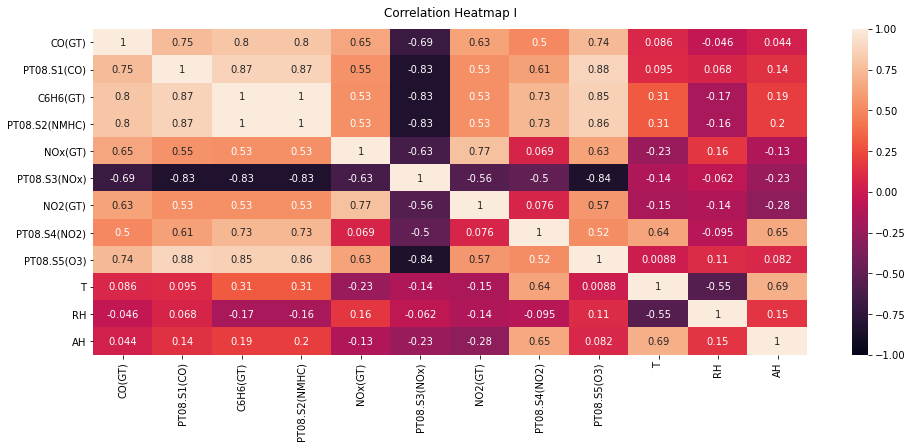

In [26]:
#Se visualizan correlaciones entre variables para estudio y entendimiento de datos (posible reducción dimensional)
import seaborn as sb
plt.figure(figsize=(16, 6))
heatmap = sb.heatmap(trusted_data.corr(method='spearman'), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap I', fontdict={'fontsize':12}, pad=12);


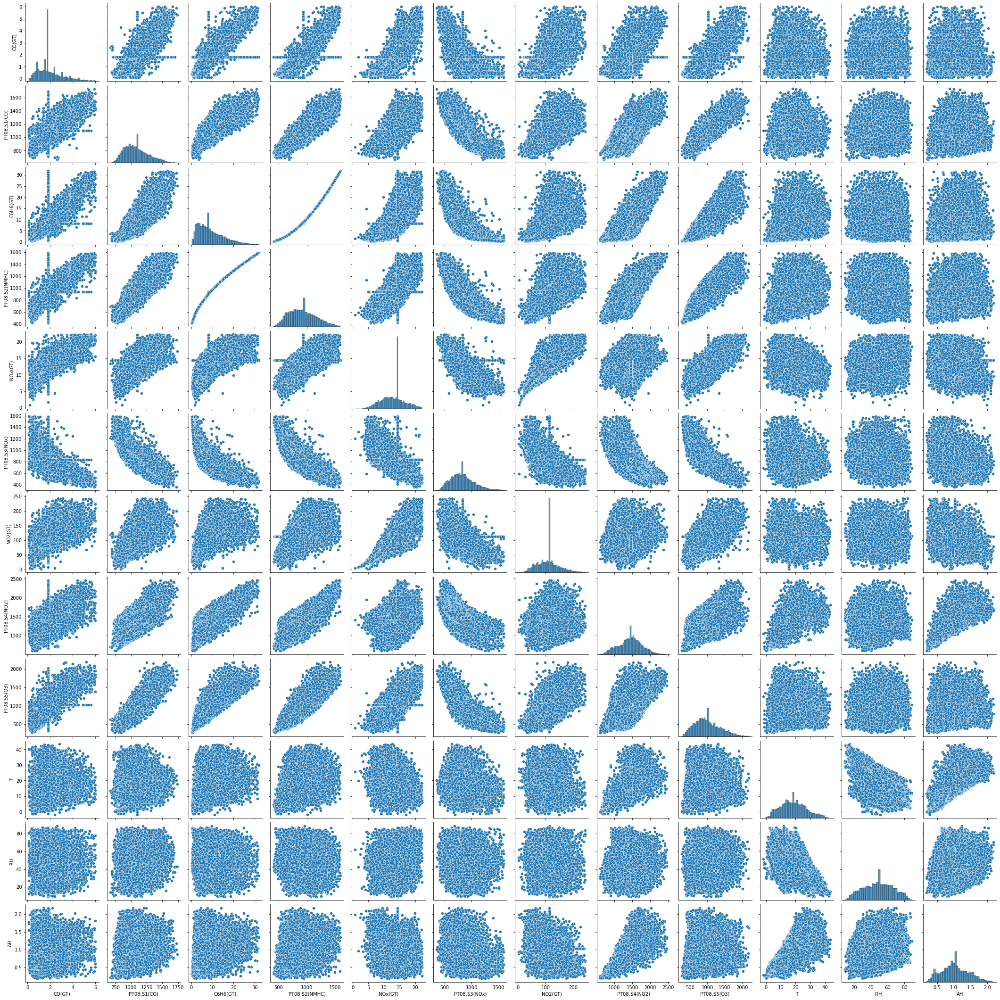

In [27]:
#Se revisualiza la relación entre pares de variables
sns.pairplot(trusted_data)

In [28]:
#Se genera grafico visualizador de un par de variables para ver más a detalle relación entre sí.
fig = px.scatter(trusted_data, x='C6H6(GT)', y='AH')
fig.show()

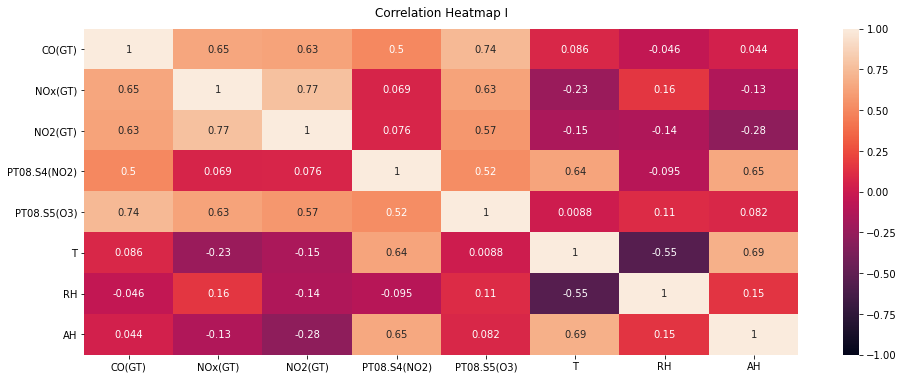

In [29]:
#Se establece empíricamente el umbral de abs(corr)>=0.8 y se observan variables altamente correlacionada, por lo que se descartan del análisis.
trusted_data = trusted_data.drop(['C6H6(GT)','PT08.S1(CO)','PT08.S2(NMHC)','PT08.S3(NOx)'],axis='columns')

#Se vuelve a imprimir matriz de correlaciones para observar nuevos coeficientes.
plt.figure(figsize=(16, 6))
heatmap = sb.heatmap(trusted_data.corr(method='spearman'), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap I', fontdict={'fontsize':12}, pad=12);

## <b>Modelado</b>

In [30]:
# Se saca copia de los datos que serán trabajados e ingestados para trabajar con modelos
refined_data = trusted_data.copy()

X = refined_data.drop(columns=['CO(GT)'], axis=1)
y = refined_data['CO(GT)']

# Se dividen los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=False)   

min_max_scaler = MinMaxScaler()
X_train_scaled = min_max_scaler.fit_transform(X_train)
X_test_scaled = min_max_scaler.transform(X_test)
tscv = TimeSeriesSplit(n_splits=2)


In [31]:
print(X_train.shape, y_train.shape)

(7079, 7) (7079,)


In [32]:
print(X_test.shape, y_test.shape)

(1770, 7) (1770,)


In [33]:
def CV(model, X, y, cv):
    model_fitted = model.fit(X,y)
    CV_score = np.mean(cross_val_score(estimator=model_fitted, X=X, y=y, cv=cv))
    print('Mean CV score for 2 folds: ' , np.round(CV_score, 7))
    
def model_evaluation(estimator, X_train, y_train, X_test, y_test):
  estimator.fit(X_train, y_train)
  predicted_train_values = estimator.predict(X_train)
  predicted_test_values = estimator.predict(X_test)
  scores = pd.DataFrame({
                        'train RMSE': [np.sqrt(mean_squared_error(y_train, predicted_train_values))],
                        'test RMSE':  [np.sqrt(mean_squared_error(y_test, predicted_test_values))],
                        'train R2':   [r2_score(y_train, predicted_train_values)],
                        'test R2':    [r2_score(y_test, predicted_test_values)]
                        })
  return scores

def check_best_params(estimator):
  return estimator.best_params_

## <b>Modelo 1. Regresión Lineal Simple</b>

In [34]:
#Modelo 1. Regresión lineal simple
CV(LinearRegression(), X_train_scaled, y_train, tscv)

Mean CV score for 2 folds:  0.4804536


In [35]:
#Evaluación de modelo
model_evaluation(LinearRegression(), X_train_scaled, y_train, X_test_scaled, y_test)

,train RMSE,test RMSE,train R2,test R2
0,0.557681,0.631438,0.72594,0.675798
